PROJET N°7-3 : DRIFT
====================

***Implémentez un modèle de scoring***

**Auteur:** *Jean EMIDIO*

**But**

- Vous êtes Data Scientist au sein d'une société financière, nommée "Prêt à dépenser", qui propose des crédits à la consommation pour des personnes ayant peu ou pas du tout d'historique de prêt.

- L’entreprise souhaite mettre en œuvre un outil de “scoring crédit” pour calculer la probabilité qu’un client rembourse son crédit, puis classifie la demande en crédit accordé ou refusé. Elle souhaite donc développer un algorithme de classification en s’appuyant sur des sources de données variées (données comportementales, données provenant d'autres institutions financières, etc.)

**Mission 1**

- Construire un modèle de scoring qui donnera une prédiction sur la probabilité de faillite d'un client de façon automatique.
- Analyser les features qui contribuent le plus au modèle, d’une manière générale (feature importance globale) et au niveau d’un client (feature importance locale), afin, dans un soucis de transparence, de permettre à un chargé d’études de mieux comprendre le score attribué par le modèle.
- Mettre en production le modèle de scoring de prédiction à l’aide d’une API et réaliser une interface de test de cette API.
- Mettre en œuvre une approche globale MLOps de bout en bout, du tracking des expérimentations à l’analyse en production du data drift.

**Mission 2**

Afin de pouvoir faire évoluer régulièrement le modèle, je souhaite tester la mise en œuvre une démarche de type MLOps d’automatisation et d’industrialisation de la gestion du cycle de vie du modèle. 

Vous trouverez en pièce jointe la liste d’outils à utiliser pour créer une plateforme MLOps qui s’appuie sur des outils Open Source. 

Je souhaite que vous puissiez mettre en oeuvre au minimum les étapes orientées MLOps suivantes : 

- Dans le notebook d’entraînement des modèles, générer à l’aide de MLFlow un tracking d'expérimentations
- Lancer l’interface web 'UI MLFlow" d'affichage des résultats du tracking
- Réaliser avec MLFlow un stockage centralisé des modèles dans un “model registry”
- Tester le serving MLFlow
- Gérer le code avec le logiciel de version Git
- Partager le code sur Github pour assurer une intégration continue
- Utiliser Github Actions pour le déploiement continu et automatisé du code de l’API sur le cloud
- Concevoir des tests unitaires avec Pytest (ou Unittest) et les exécuter de manière automatisée lors du build réalisé par Github Actions
 
J’ai également rassemblé des conseils pour vous aider à vous lancer dans ce projet !

Concernant l’élaboration du modèle soyez vigilant sur deux points spécifiques au contexte métier : 
- Le déséquilibre entre le nombre de bons et de moins bons clients doit être pris en compte pour élaborer un modèle pertinent, avec une méthode au choix
- Le déséquilibre du coût métier entre un faux négatif (FN - mauvais client prédit bon client : donc crédit accordé et perte en capital) et un faux positif (FP - bon client prédit mauvais : donc refus crédit et manque à gagner en marge)
Vous pourrez supposer, par exemple, que le coût d’un FN est dix fois supérieur au coût d’un FP
Vous créerez un score “métier” (minimisation du coût d’erreur de prédiction des FN et FP) pour comparer les modèles, afin de choisir le meilleur modèle et ses meilleurs hyperparamètres. Attention cette minimisation du coût métier doit passer par l’optimisation du seuil qui détermine, à partir d’une probabilité, la classe 0 ou 1 (un “predict” suppose un seuil à 0.5 qui n’est pas forcément l’optimum)
En parallèle, maintenez pour comparaison et contrôle des mesures plus techniques, telles que l’AUC et l’accuracy 

D’autre part je souhaite que vous mettiez en œuvre une démarche d’élaboration des modèles avec Cross-Validation et optimisation des hyperparamètres, via GridsearchCV ou équivalent.

Un dernier conseil : si vous obtenez des scores supérieurs au 1er du challenge Kaggle (AUC > 0.82), posez-vous la question si vous n’avez pas de l’overfitting dans votre modèle !

Vous exposerez votre modèle de prédiction sous forme d’une API qui permet de calculer la probabilité de défaut du client, ainsi que sa classe (accepté ou refusé) en fonction du seuil optimisé d’un point de vue métier.

Le déploiement de l’API sera réalisée sur une plateforme Cloud, de préférence une solution gratuite.

Je vous propose d’utiliser un Notebook ou une application Streamlit pour réaliser en local  l’interface de test de l’API.

**Outils Open Source pour élaborer une plateforme MLOps**

- MLFlow pour la gestion “d’expériences” et leur tracking lors de la phase d’entraînement des modèles, ainsi que la visualisation des résultats avec MLFlow UI
- MLFlow pour le stockage centralisé des modèles dans un “model registry” et le serving
- Git, logiciel de version de code, pour suivre les modifications du code final de l’API de prédiction à déployer
- Github pour stocker et partager sur le cloud le code de l’API, alimenté par un “push” Git et ainsi assurer une intégration continue
- Github Actions pour le déploiement continu et automatisé du code de l’API sur le cloud
- Pytest (ou Unittest) pour concevoir les tests unitaires et les exécuter de manière automatisée lors du build réalisé par Github

**Objectifs pédagogiques**

- Définir et mettre en œuvre un pipeline d’entraînement des modèles
- Définir la stratégie d’élaboration d’un modèle d’apprentissage supervisé
- Évaluer les performances des modèles d’apprentissage supervisé
- Mettre en œuvre un logiciel de version de code
- Suivre la performance d’un modèle en production et en assurer la maintenance
- Concevoir un déploiement continu d'un moteur d’inférence sur une plateforme Cloud

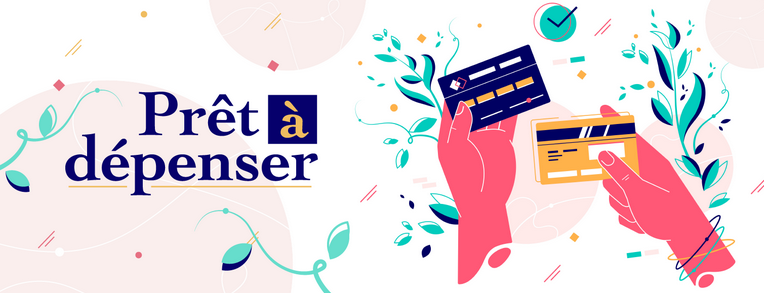

**Table of contents**<a id='toc0_'></a>    
- [Les datas](#toc1_)    
  - [Import](#toc1_1_)    
  - [Initialisations](#toc1_2_)    
  - [Fonctions](#toc1_3_)    
  - [Dataset](#toc1_4_)    
- [Data Drift](#toc2_)    

<!-- vscode-jupyter-toc-config
	numbering=false
	anchor=true
	flat=false
	minLevel=1
	maxLevel=6
	/vscode-jupyter-toc-config -->
<!-- THIS CELL WILL BE REPLACED ON TOC UPDATE. DO NOT WRITE YOUR TEXT IN THIS CELL -->

# <a id='toc1_'></a>[Les datas](#toc0_)

## <a id='toc1_1_'></a>[Import](#toc0_)

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from evidently import Report
from evidently.presets import DataDriftPreset

## <a id='toc1_2_'></a>[Initialisations](#toc0_)

In [3]:
# Initialisations :
SEED = 15 # Ici on définit RANDOM_SEED = constant seulement pour la reproductibilité

## <a id='toc1_3_'></a>[Fonctions](#toc0_)

In [4]:
import fonctions_python as fc
import importlib
importlib.reload(fc)

<module 'fonctions_python' from 'c:\\Users\\jme1401\\Desktop\\OCR\\7-Implémentez un modèle de scoring\\Datas\\fonctions_python.py'>

## <a id='toc1_4_'></a>[Dataset](#toc0_)

In [5]:
path_datas_init = "./datas/datas_init/"
path_datas_save = "./datas/datas_save/"
path_models = "./models/"

In [6]:
df_datas_train = pd.read_csv(path_datas_save + 'df_datas_train_cleaned.csv').set_index('SK_ID_CURR')
df_datas_test = pd.read_csv(path_datas_save + 'df_datas_test_cleaned.csv').set_index('SK_ID_CURR')

# <a id='toc2_'></a>[Data Drift](#toc0_)

Le Data Drift est une variation des données du monde réel par rapport aux données utilisées pour tester et valider le modèle avant de le déployer en production. L’une des causes principales est la dimension temporelle.

Le data drift peut affecter les performances du modèle Machine Learning. Il existe différents types de drift. Il peut y avoir des changements dans la distribution cible, ou encore un *covariate drift* qui est un changement dans la distribution des données d'entrée (par exemple une variable aura une autre catégorie).

L'approche pour détecter le data drift consiste à utiliser des tests statistiques qui comparent la distribution des données de référence (reference data) et des données actuelles ou current data (données de production). Si la différence entre deux distributions est significative alors un drift s'est produit. 
Pour un dataset volumineux (avec > 1 000 observations dans l'ensemble de données de référence), la Distance de Wasserstein est utilisée pour les colonnes numériques (n_unique > 5), et pour les colonnes catégorielles ou numériques (avec n_unique <= 5) c'est la Divergence de Jensen--Shannon qui est appliquée.

In [7]:
df_datas_train.shape

(307507, 560)

In [8]:
df_datas_test.shape

(48744, 559)

In [9]:
df_reference = df_datas_train.drop(['TARGET'],axis=1).iloc[:48744, :]
df_current = df_datas_test

In [10]:
data_drift_report = Report(
    [
        DataDriftPreset(method="psi")
    ],
    include_tests="True"
)

my_report = data_drift_report.run(
    reference_data = df_reference,
    current_data = df_current
)
my_report

C:\Users\jme1401\AppData\Roaming\Python\Python312\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\jme1401\AppData\Roaming\Python\Python312\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\jme1401\AppData\Roaming\Python\Python312\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
C:\Users\jme1401\AppData\Roaming\Python\Python312\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]
C:\Users\jme1401\AppData\Roaming\Python\Python312\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning:

invalid value encountered in divide

C:\Users\jme1401\AppData\Roaming\Python\Python312\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning:

invalid value encountered in divide

C:\Users\j

On constate donc qu'il n'y a pas de data drift entre nos données de référence (données de train) et nos données actuelles (données de test), bien qu'un léger drift de 6.08% ait été détecté dans 35 de nos colonnes.

In [12]:
my_report.save_html("drift_report.html")